In [2]:
import os
os.chdir("../../")

In [4]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
plt.style.use('dark_background')

In [5]:
path_cleaned = "data/cleaned-data.csv"
df = pd.read_csv(path_cleaned)

In [6]:
df.describe()

,tph_tratamiento_original,di-101,espumante_std,xantato,nahs,recuperacion_global,%cu_alimen._rougher,%fe_alimen._rougher,%sol_alimen._rougher,ph_rougher,...,nivel_columna_505,nivel_columna_506,nivel_columna_507,nivel_columna_508,nivel_columna_509,nivel_columna_510,nivel_columna_511,espumante_sag,colector_primario,%cu_conc_final
count,115105.00000,115105.000000,115105.000000,115105.000000,115105.000000,115105.000000,115105.000000,115105.000000,115105.000000,115105.000000,...,115105.000000,115105.000000,115105.000000,115105.000000,115105.000000,115105.000000,115105.000000,115105.000000,115105.000000,115105.000000
mean,6605.90012,26.226733,16.010475,1.048448,77.071942,83.380090,0.821865,2.034795,26.110524,10.528647,...,61.940731,85.797105,75.175968,76.120267,77.571344,71.707646,75.882467,24.836525,0.632379,27.013755
std,911.17245,5.059564,4.558553,1.290765,57.266211,3.764214,0.146965,0.513804,2.029005,0.215967,...,23.768409,393.398378,22.445358,21.815749,22.769757,19.985541,23.158013,343.474982,1.840161,7.835750
min,4800.54000,0.000000,5.000000,-0.090000,0.000000,60.000000,-3.530000,-17.960000,-21.450000,7.580000,...,0.000000,0.700000,0.160000,0.000000,3.130000,0.000000,3.860000,0.000000,-0.820000,-44.770000
25%,5932.99000,23.730000,13.210000,0.000000,28.170000,81.680000,0.730000,1.740000,25.160000,10.430000,...,44.870000,51.830000,59.840000,60.270000,60.520000,59.150000,59.865000,0.000000,0.000000,24.860000
50%,6641.47000,26.040000,16.010000,0.500000,66.295000,83.830000,0.810000,1.940000,26.390000,10.540000,...,56.690000,69.670000,75.670000,78.450000,79.226275,72.730000,76.690000,0.060000,0.030000,27.040000
75%,7308.47000,29.950000,18.970000,1.990000,122.140000,85.770000,0.890000,2.190000,27.220000,10.650000,...,76.080000,84.810000,89.760000,90.140000,90.230000,85.270000,90.020000,0.220000,0.240000,29.190000
max,9052.91000,82.900000,88.360000,55.080000,300.000000,100.000000,3.490000,6.570000,40.000000,11.840000,...,130.000000,16253.120000,130.000000,130.000000,130.000000,130.000000,130.000000,9890.720000,29.960000,1249.230000


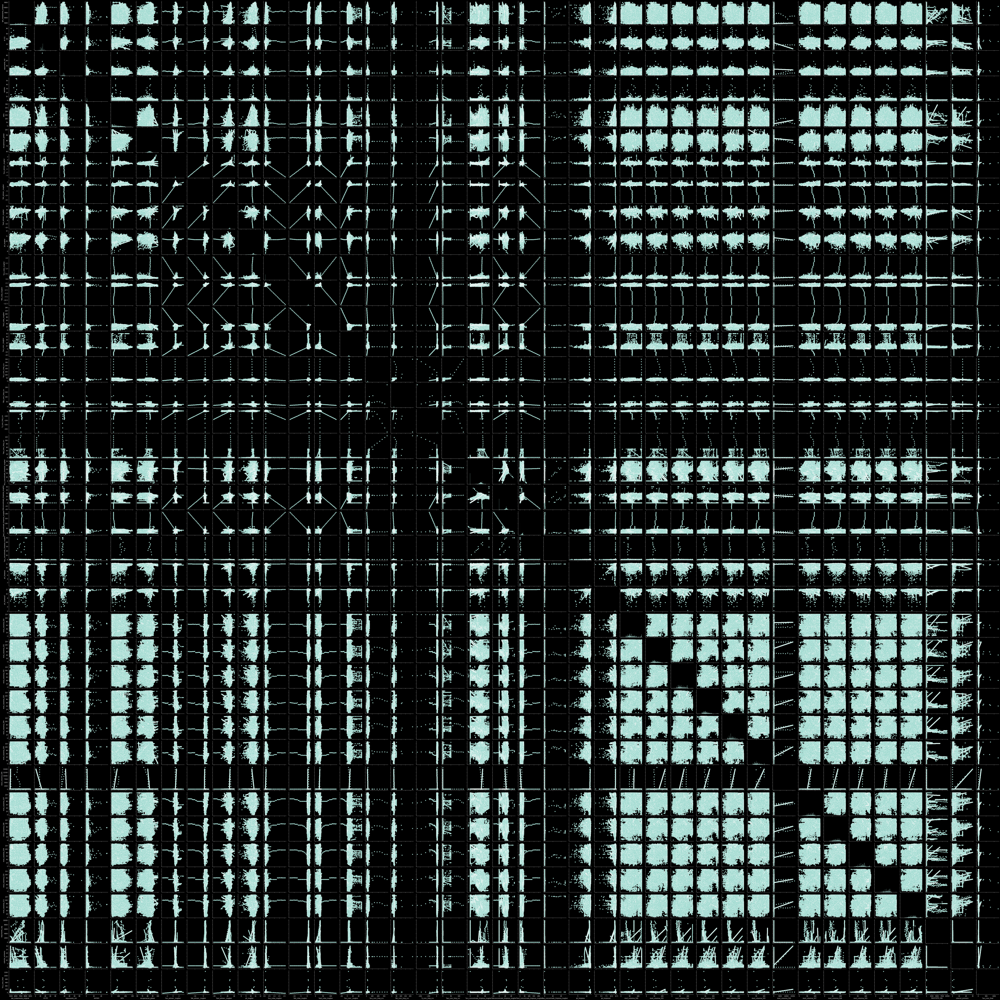

In [7]:
sns.pairplot(df)

### Add Logarithmic Features
When we need to apply log(x+1), logging our features.
Firstly, to improve model fit. For instance if your residuals aren't normally distributed then taking the logarithm of a skewed variable may improve the fit by altering the scale and making the variable more "normally" distributed. For instance, earnings is truncated at zero and often exhibits positive skew. If the variable has negatve skew you could firstly invert the variable before taking the logarithm. I'm thinking here particularly of Likert scales that are inputed as continuous variables. While this usually applies to the dependent variable you occasionally have problems with the residuals (e.g. heteroscedasticity) caused by an independent variable which can be sometimes corrected by taking the logarithm of that variable. 

In [8]:
columns_log = ["xantato", "nahs", "%fe_alimen._rougher", "%cu_colas_rougher"]
for col in columns_log:
    print(col)
    new_col = "log_" + col
    df[new_col] = df[col].apply(lambda x: np.log(x + 1))
    df.drop(columns=[col], inplace=True)

xantato
nahs
%fe_alimen._rougher
%cu_colas_rougher
